# **COVID-19 Global Data Tracker**

![covid_report](https://upload.wikimedia.org/wikipedia/commons/6/6b/COVID-19_Cases_World_Map_Report_March_2020.png)

From [Wikimedia Commons](https://commons.wikimedia.org/wiki/File:COVID-19_Cases_World_Map_Report_March_2020.png)

### **Introduction**

COVID-19, caused by the novel coronavirus SARS-CoV-2, emerged in late 2019 in Wuhan, China, and rapidly escalated into a global pandemic. The virus spread across continents, leading to widespread illness, significant mortality, and unprecedented disruptions to daily life, economies, and healthcare systems. Governments and organizations worldwide responded with a range of interventions, from lockdowns and travel restrictions to mass vaccination campaigns. The pandemic's course has been shaped by evolving variants, public health measures, and the global effort to develop and distribute vaccines. Understanding the pandemic's impact requires comprehensive data analysis to reveal patterns, disparities, and lessons for future preparedness.

### **Project Statement**

This notebook provides a thorough, data-driven exploration of the COVID-19 pandemic at a global scale. By leveraging real-world data, we analyze trends in cases, deaths, and vaccinations, and examine how demographic and socioeconomic factors have influenced outcomes. The project aims to generate actionable insights through visualizations, statistical analysis, and regression modeling, supporting evidence-based recommendations for public health policy and future crisis response.

### **Problem Description**

Despite the abundance of COVID-19 data, there remain significant gaps in understanding how and why the pandemic's impact has varied so widely between countries and regions. Factors such as healthcare capacity, population structure, economic resources, and policy responses have all played roles, but their relative influence is complex and context-dependent. This project addresses the challenge of integrating and analyzing diverse data sources to uncover the drivers of COVID-19 outcomes, highlight disparities, and inform more effective and equitable responses to current and future global health threats.

### **Objectives**

1. Import, clean, and preprocess global COVID-19 data for robust analysis.
2. Analyze and visualize time trends in cases, deaths, and vaccinations across countries and continents.
3. Compare key COVID-19 metrics between countries and regions, highlighting disparities and patterns.
4. Apply statistical and regression analysis to explore relationships between pandemic outcomes and demographic or socioeconomic factors.
5. Communicate findings through clear visualizations, narrative insights, and actionable recommendations in a well-structured notebook.

### **Import Libraries**

In [2]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio

# Ensure exportable rendering
pio.renderers.default = 'notebook'

### **Loading the File**

In [3]:
# Load the dataset
df = pd.read_csv('owid-covid-data.csv')
# Display the first few rows of the dataset
df.head()

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,gdp_per_capita,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index
0,AFG,Asia,Afghanistan,2020-02-24,1.0,1.0,NaN,NaN,NaN,NaN,...,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511
1,AFG,Asia,Afghanistan,2020-02-25,1.0,0.0,NaN,NaN,NaN,NaN,...,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511
2,AFG,Asia,Afghanistan,2020-02-26,1.0,0.0,NaN,NaN,NaN,NaN,...,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511
3,AFG,Asia,Afghanistan,2020-02-27,1.0,0.0,NaN,NaN,NaN,NaN,...,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511
4,AFG,Asia,Afghanistan,2020-02-28,1.0,0.0,NaN,NaN,NaN,NaN,...,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511


In [4]:
df.tail(10)

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,gdp_per_capita,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index
91016,ZWE,Africa,Zimbabwe,2021-05-15,38554.0,19.0,20.000,1582.0,0.0,0.857,...,1899.775,21.4,307.846,1.82,1.6,30.7,36.791,1.7,61.49,0.571
91017,ZWE,Africa,Zimbabwe,2021-05-16,38560.0,6.0,20.143,1582.0,0.0,0.857,...,1899.775,21.4,307.846,1.82,1.6,30.7,36.791,1.7,61.49,0.571
91018,ZWE,Africa,Zimbabwe,2021-05-17,38572.0,12.0,19.857,1582.0,0.0,0.857,...,1899.775,21.4,307.846,1.82,1.6,30.7,36.791,1.7,61.49,0.571
91019,ZWE,Africa,Zimbabwe,2021-05-18,38595.0,23.0,21.000,1583.0,1.0,0.571,...,1899.775,21.4,307.846,1.82,1.6,30.7,36.791,1.7,61.49,0.571
91020,ZWE,Africa,Zimbabwe,2021-05-19,38612.0,17.0,20.857,1583.0,0.0,0.571,...,1899.775,21.4,307.846,1.82,1.6,30.7,36.791,1.7,61.49,0.571
91021,ZWE,Africa,Zimbabwe,2021-05-20,38635.0,23.0,20.571,1585.0,2.0,0.429,...,1899.775,21.4,307.846,1.82,1.6,30.7,36.791,1.7,61.49,0.571
91022,ZWE,Africa,Zimbabwe,2021-05-21,38664.0,29.0,18.429,1586.0,1.0,0.571,...,1899.775,21.4,307.846,1.82,1.6,30.7,36.791,1.7,61.49,0.571
91023,ZWE,Africa,Zimbabwe,2021-05-22,38679.0,15.0,17.857,1586.0,0.0,0.571,...,1899.775,21.4,307.846,1.82,1.6,30.7,36.791,1.7,61.49,0.571
91024,ZWE,Africa,Zimbabwe,2021-05-23,38682.0,3.0,17.429,1586.0,0.0,0.571,...,1899.775,21.4,307.846,1.82,1.6,30.7,36.791,1.7,61.49,0.571
91025,ZWE,Africa,Zimbabwe,2021-05-24,38696.0,14.0,17.714,1586.0,0.0,0.571,...,1899.775,21.4,307.846,1.82,1.6,30.7,36.791,1.7,61.49,0.571


### **Data Preliminaries**

In [5]:
# Dataset shape
print(f"Dataset shape: {df.shape}")

Dataset shape: (91026, 59)


In [6]:
# Check the number of feature columns
print(f"Number of feature columns: {len(df.columns)}")

Number of feature columns: 59


In [7]:
# Check the number of rows in the dataset   
print(f"Number of rows in the dataset: {len(df)}")

Number of rows in the dataset: 91026


In [8]:
# Check on memory usage
memory_usage = df.memory_usage(deep=True)
# Convert memory usage to MB for better readability 
memory_usage = (memory_usage / (1024 ** 2)).sort_values(ascending=False)  # Convert to MB
print(f"Memory usage (in MB):\n{memory_usage}")

Memory usage (in MB):
date                                     5.121740
location                                 4.990594
continent                                4.751949
iso_code                                 4.537417
tests_units                              4.252325
total_deaths                             0.694473
new_cases                                0.694473
total_cases                              0.694473
new_deaths_smoothed                      0.694473
new_deaths                               0.694473
total_cases_per_million                  0.694473
new_cases_smoothed                       0.694473
hosp_patients                            0.694473
new_cases_smoothed_per_million           0.694473
total_deaths_per_million                 0.694473
new_deaths_per_million                   0.694473
new_deaths_smoothed_per_million          0.694473
reproduction_rate                        0.694473
icu_patients                             0.694473
icu_patients_per_million    

In [9]:
# Dataset information
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 91026 entries, 0 to 91025
Data columns (total 59 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   iso_code                               91026 non-null  object 
 1   continent                              86699 non-null  object 
 2   location                               91026 non-null  object 
 3   date                                   91026 non-null  object 
 4   total_cases                            88336 non-null  float64
 5   new_cases                              88335 non-null  float64
 6   new_cases_smoothed                     87328 non-null  float64
 7   total_deaths                           78484 non-null  float64
 8   new_deaths                             78642 non-null  float64
 9   new_deaths_smoothed                    87328 non-null  float64
 10  total_cases_per_million                87863 non-null  float64
 11  ne

In [10]:
# Check missing values
missing_values = df.isnull().sum()
print(missing_values[missing_values > 0])

continent                                 4327
total_cases                               2690
new_cases                                 2691
new_cases_smoothed                        3698
total_deaths                             12542
new_deaths                               12384
new_deaths_smoothed                       3698
total_cases_per_million                   3163
new_cases_per_million                     3164
new_cases_smoothed_per_million            4166
total_deaths_per_million                 13002
new_deaths_per_million                   12844
new_deaths_smoothed_per_million           4166
reproduction_rate                        17659
icu_patients                             81850
icu_patients_per_million                 81850
hosp_patients                            79611
hosp_patients_per_million                79611
weekly_icu_admissions                    90196
weekly_icu_admissions_per_million        90196
weekly_hosp_admissions                   89580
weekly_hosp_a

In [11]:
# Check on duplicates
duplicates = df.duplicated().sum()
print(f"Number of duplicate rows: {duplicates}")

Number of duplicate rows: 0


In [12]:
# Check column names
print(df.columns)

Index(['iso_code', 'continent', 'location', 'date', 'total_cases', 'new_cases',
       'new_cases_smoothed', 'total_deaths', 'new_deaths',
       'new_deaths_smoothed', 'total_cases_per_million',
       'new_cases_per_million', 'new_cases_smoothed_per_million',
       'total_deaths_per_million', 'new_deaths_per_million',
       'new_deaths_smoothed_per_million', 'reproduction_rate', 'icu_patients',
       'icu_patients_per_million', 'hosp_patients',
       'hosp_patients_per_million', 'weekly_icu_admissions',
       'weekly_icu_admissions_per_million', 'weekly_hosp_admissions',
       'weekly_hosp_admissions_per_million', 'new_tests', 'total_tests',
       'total_tests_per_thousand', 'new_tests_per_thousand',
       'new_tests_smoothed', 'new_tests_smoothed_per_thousand',
       'positive_rate', 'tests_per_case', 'tests_units', 'total_vaccinations',
       'people_vaccinated', 'people_fully_vaccinated', 'new_vaccinations',
       'new_vaccinations_smoothed', 'total_vaccinations_per_hun

In [13]:
# Check on statistics
df.describe()

,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_cases_per_million,new_cases_per_million,new_cases_smoothed_per_million,total_deaths_per_million,...,gdp_per_capita,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index
count,8.833600e+04,88335.000000,87328.000000,7.848400e+04,78642.000000,87328.000000,87863.000000,87862.000000,86860.000000,78024.000000,...,81972.000000,55479.000000,82163.000000,84019.000000,64338.000000,63393.000000,41288.000000,74934.000000,86432.000000,82351.000000
mean,9.151563e+05,6033.622743,6046.602763,2.479388e+04,141.643664,126.433556,11220.125030,75.755854,75.892982,245.707748,...,19296.887209,13.373408,258.044821,7.876693,10.537168,32.666667,50.881769,3.029373,73.231286,0.727804
std,6.322927e+06,38089.918376,37733.973544,1.476747e+05,777.835074,717.118005,21227.092043,196.149038,155.744273,429.926840,...,19954.883034,19.951487,118.858771,4.062795,10.425066,13.472618,31.761800,2.461568,7.564003,0.150413
min,1.000000e+00,-74347.000000,-6223.000000,1.000000e+00,-1918.000000,-232.143000,0.001000,-2153.437000,-276.825000,0.001000,...,661.240000,0.100000,79.370000,0.990000,0.100000,7.700000,1.188000,0.100000,53.280000,0.394000
25%,1.055000e+03,2.000000,7.143000,4.800000e+01,0.000000,0.000000,220.891500,0.202000,1.212750,7.296750,...,4466.507000,0.600000,167.295000,5.310000,1.900000,21.600000,20.859000,1.300000,67.920000,0.602000
50%,1.161100e+04,70.000000,87.286000,3.330000e+02,2.000000,1.286000,1514.078000,7.846000,10.428000,43.718000,...,12951.839000,2.200000,242.648000,7.110000,6.300000,31.400000,49.839000,2.400000,74.620000,0.748000
75%,1.232172e+05,783.000000,819.714000,3.229250e+03,18.000000,14.000000,11074.352500,70.163500,78.714500,267.625250,...,27216.445000,21.200000,329.635000,10.080000,19.300000,41.100000,83.241000,3.861000,78.740000,0.848000
max,1.673164e+08,905992.000000,826374.286000,3.473036e+06,17906.000000,14436.286000,175616.385000,18293.675000,4083.500000,3059.931000,...,116935.600000,77.600000,724.417000,30.530000,44.000000,78.100000,100.000000,13.800000,86.750000,0.957000


### **Data Cleaning**

In [14]:
# Select columns based on dtype
numeric_columns = df.select_dtypes(include=["number"]).columns.to_list()
# Display numeric columns
print(f"Numeric columns: {numeric_columns}")

Numeric columns: ['total_cases', 'new_cases', 'new_cases_smoothed', 'total_deaths', 'new_deaths', 'new_deaths_smoothed', 'total_cases_per_million', 'new_cases_per_million', 'new_cases_smoothed_per_million', 'total_deaths_per_million', 'new_deaths_per_million', 'new_deaths_smoothed_per_million', 'reproduction_rate', 'icu_patients', 'icu_patients_per_million', 'hosp_patients', 'hosp_patients_per_million', 'weekly_icu_admissions', 'weekly_icu_admissions_per_million', 'weekly_hosp_admissions', 'weekly_hosp_admissions_per_million', 'new_tests', 'total_tests', 'total_tests_per_thousand', 'new_tests_per_thousand', 'new_tests_smoothed', 'new_tests_smoothed_per_thousand', 'positive_rate', 'tests_per_case', 'total_vaccinations', 'people_vaccinated', 'people_fully_vaccinated', 'new_vaccinations', 'new_vaccinations_smoothed', 'total_vaccinations_per_hundred', 'people_vaccinated_per_hundred', 'people_fully_vaccinated_per_hundred', 'new_vaccinations_smoothed_per_million', 'stringency_index', 'popula

In [15]:
# Check for minimum in numeric columns
min_values = df[numeric_columns].min().sort_values(ascending=True)
print(f"Minimum values:\n{min_values.head(15)}")

Minimum values:
new_tests                           -239172.000
new_cases                            -74347.000
new_cases_smoothed                    -6223.000
new_cases_per_million                 -2153.437
new_deaths                            -1918.000
new_cases_smoothed_per_million         -276.825
new_deaths_smoothed                    -232.143
new_deaths_per_million                  -76.445
new_tests_per_thousand                  -23.010
new_deaths_smoothed_per_million         -10.921
reproduction_rate                        -0.010
icu_patients_per_million                  0.000
hosp_patients_per_million                 0.000
weekly_icu_admissions_per_million         0.000
hosp_patients                             0.000
dtype: float64


- Columns such as 'new_tests', 'new_cases', 'new_cases_smoothed', 'new_deaths', and others have negative minimum values.
- Negative values in these columns are not expected in the context of COVID-19 data (e.g., new cases or deaths cannot be negative).
- The next step is to correct these anomalies by replacing negative values with their absolute values in all numeric columns

In [16]:
# Replace negative values with their absolute values in all numeric columns
df[numeric_columns] = df[numeric_columns].abs()

In [17]:
new_min_values = df[numeric_columns].min().sort_values(ascending=True)
print(f"New minimum values:\n{new_min_values.head(15)}")

New minimum values:
new_cases                            0.0
new_cases_smoothed                   0.0
new_deaths_smoothed                  0.0
new_deaths                           0.0
new_cases_per_million                0.0
new_deaths_smoothed_per_million      0.0
new_deaths_per_million               0.0
new_cases_smoothed_per_million       0.0
icu_patients_per_million             0.0
icu_patients                         0.0
hosp_patients                        0.0
reproduction_rate                    0.0
weekly_hosp_admissions               0.0
weekly_icu_admissions_per_million    0.0
weekly_icu_admissions                0.0
dtype: float64


In [18]:
# Relace NaN values with 0 in all numeric columns
df[numeric_columns] = df[numeric_columns].fillna(0)

In [19]:
# Check for null values
df[numeric_columns].isnull().sum()

total_cases                              0
new_cases                                0
new_cases_smoothed                       0
total_deaths                             0
new_deaths                               0
new_deaths_smoothed                      0
total_cases_per_million                  0
new_cases_per_million                    0
new_cases_smoothed_per_million           0
total_deaths_per_million                 0
new_deaths_per_million                   0
new_deaths_smoothed_per_million          0
reproduction_rate                        0
icu_patients                             0
icu_patients_per_million                 0
hosp_patients                            0
hosp_patients_per_million                0
weekly_icu_admissions                    0
weekly_icu_admissions_per_million        0
weekly_hosp_admissions                   0
weekly_hosp_admissions_per_million       0
new_tests                                0
total_tests                              0
total_tests

In [20]:
# Check for object columns
object_columns = df.select_dtypes(include=["object"]).columns.to_list()
# Display object columns
print(f"Object columns: {object_columns}")

Object columns: ['iso_code', 'continent', 'location', 'date', 'tests_units']


In [21]:
# Check % of null values for each object column
missing_values = df[object_columns].isnull().sum() / len(df) * 100
missing_values = missing_values[missing_values > 0].sort_values(ascending=False)
print(f"Missing values in object columns:\n{missing_values}")

Missing values in object columns:
tests_units    45.939622
continent       4.753587
dtype: float64


In [22]:
df.isna().sum().sort_values(ascending=False).head()

tests_units    41817
continent       4327
iso_code           0
date               0
total_cases        0
dtype: int64

In [23]:
# Drop tests units column
df.drop(columns=["tests_units"], inplace=True)

In [24]:
# Drop null values in continent column
df.dropna(subset=["continent"], inplace=True)

In [25]:
# Check on the null values
df.isna().sum().sum()

np.int64(0)

### **Exploratory Data Analysis**

#### *Continent*

In [26]:
# Check for unique values in the 'continent' column
df['continent'].value_counts()

continent
Africa           23577
Asia             21744
Europe           21643
North America    11081
South America     5523
Oceania           3131
Name: count, dtype: int64

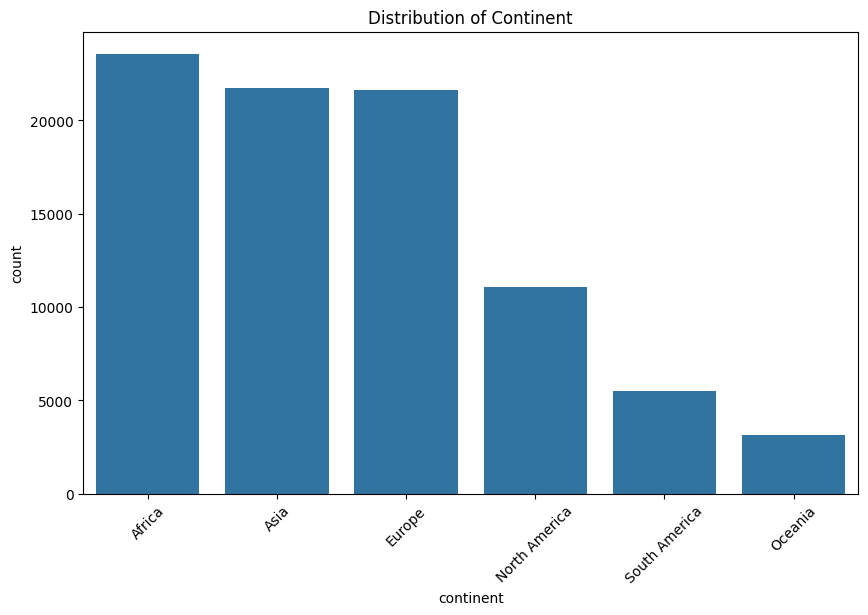

In [27]:
# Plotting the distribution of the continent column
plt.figure(figsize=(10, 6))
sns.countplot(data=df, x='continent', order=df['continent'].value_counts().index)
plt.title('Distribution of Continent')  
plt.xticks(rotation=45)
plt.show()

**`Africa`** had highest COVID-19 cases with **`Oceania`** becoming the least with `3131`

#### *Cases vs. Deaths by Continent*

In [28]:
# Get total cases by continent as float (not formatted as string/object)
df.groupby('continent')['total_cases'].sum().sort_values(ascending=False)

continent
Europe           7.022733e+09
North America    6.816519e+09
Asia             6.329689e+09
South America    4.358574e+09
Africa           8.675026e+08
Oceania          1.095399e+07
Name: total_cases, dtype: float64

In [29]:
# Total death by continent
df.groupby('continent')['total_deaths'].sum().sort_values(ascending=False)

continent
Europe           185871865.0
North America    174272500.0
South America    122792695.0
Asia             101238112.0
Africa            22074592.0
Oceania             282249.0
Name: total_deaths, dtype: float64

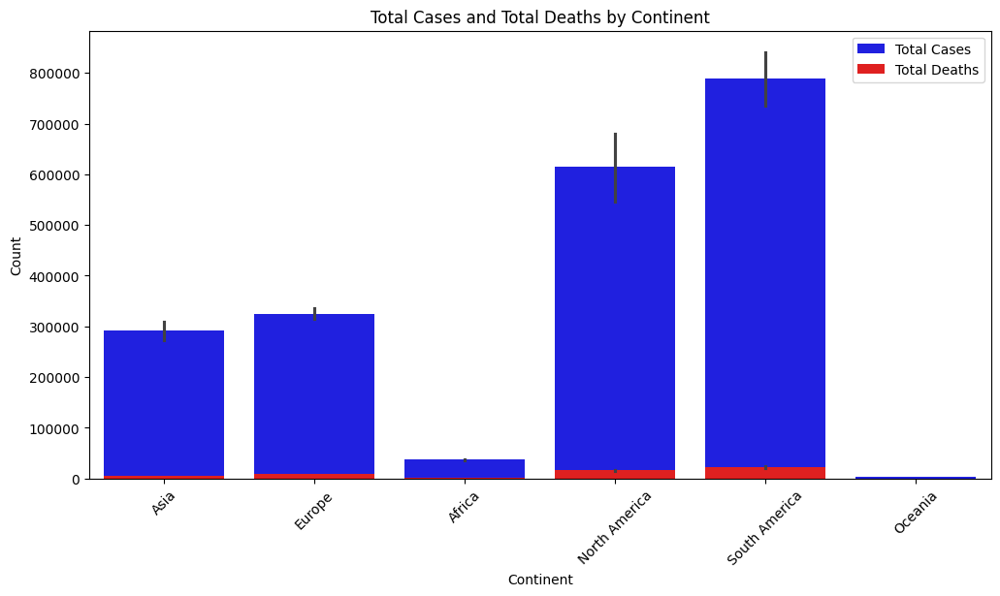

In [30]:
# Plot comparison of total cases and total deaths by continent
plt.figure(figsize=(12, 6))
sns.barplot(data=df, x='continent', y='total_cases', color='blue', label='Total Cases')
sns.barplot(data=df, x='continent', y='total_deaths', color='red', label='Total Deaths')
plt.title('Total Cases and Total Deaths by Continent')
plt.xlabel('Continent')
plt.ylabel('Count')
plt.legend()
plt.xticks(rotation=45)
plt.show()

**Key Insights:**
- **Asia and Europe** have the highest total reported cases, followed by North America and South America.
- **Africa** and **Oceania** have significantly lower case and death counts compared to other continents.
- The death segment is much smaller than the case segment for all continents, reflecting that deaths are a small fraction of total cases.
- The relative size of the death segment compared to cases can hint at differences in fatality rates, healthcare quality, or reporting practices across continents.

This visualization helps compare the pandemic's impact across continents, highlighting both the scale of infections and the burden of mortality.

#### *Time Series Analysis*

In [31]:
# Time series analysis
# Convert date column to datetime format
df['date'] = pd.to_datetime(df['date'], format='%Y-%m-%d')
# Check the data type of the date column
print(f"Data type of date column: {df['date'].dtype}")

Data type of date column: datetime64[ns]


#### *1. Cases by Continent*

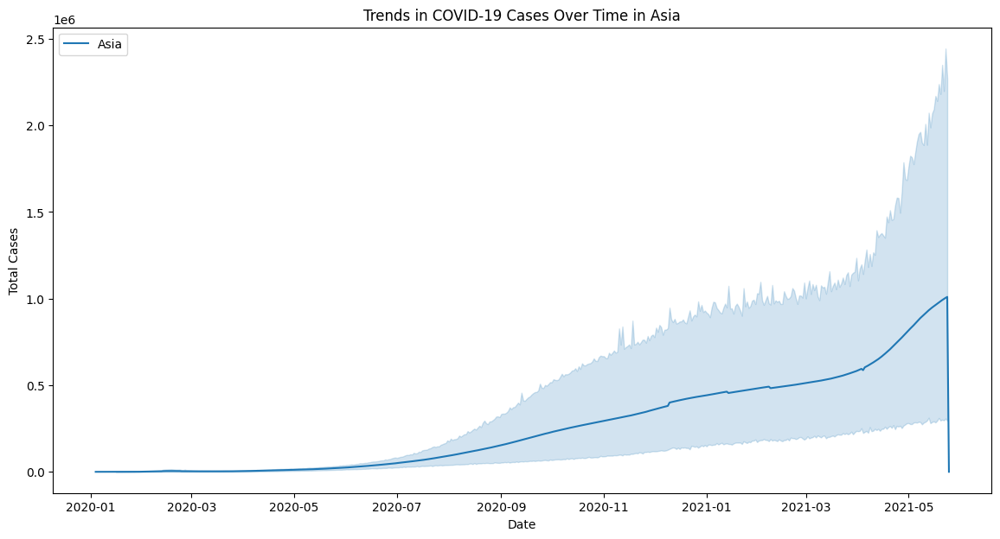

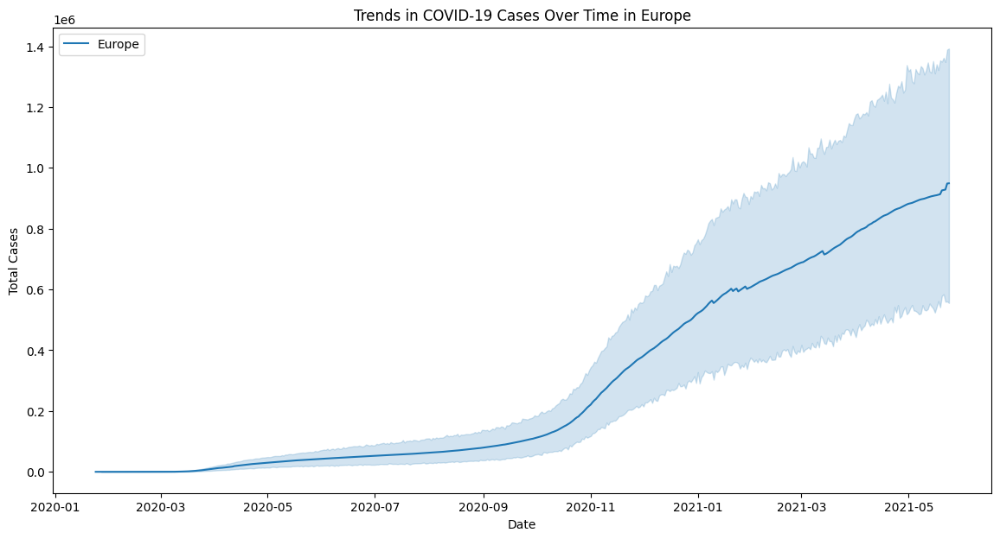

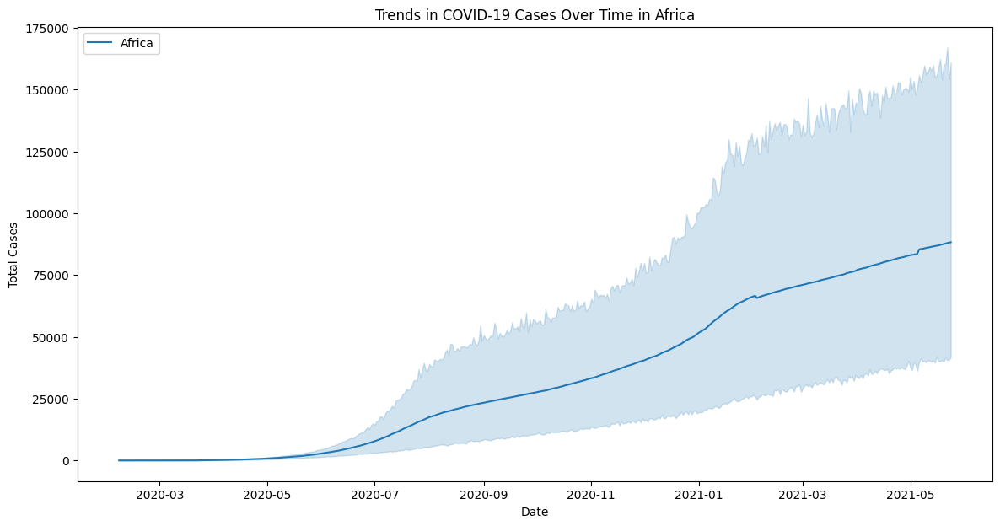

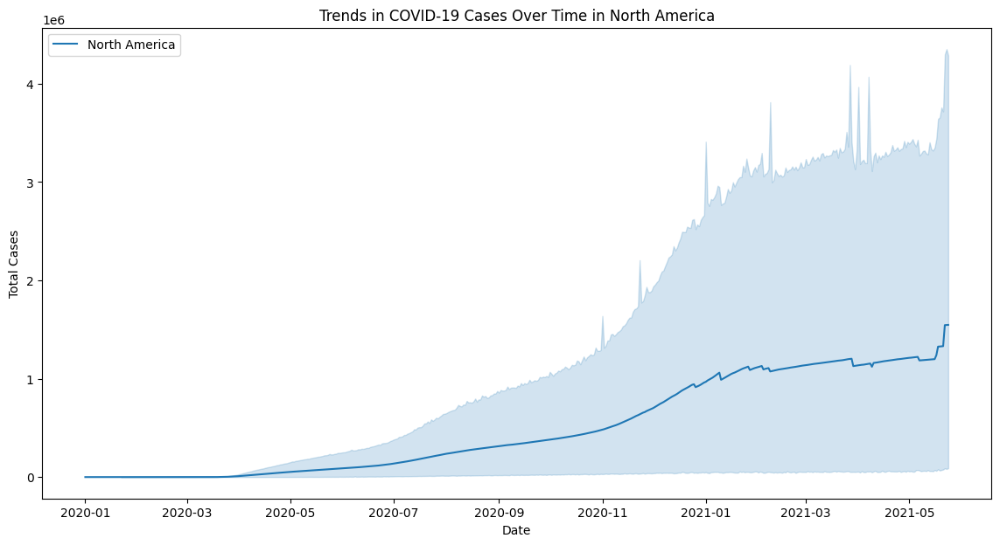

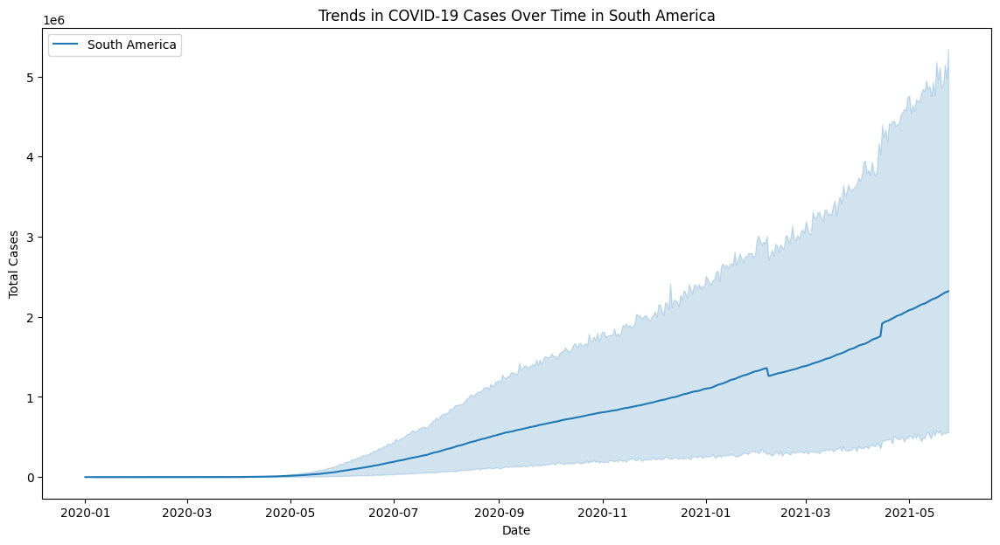

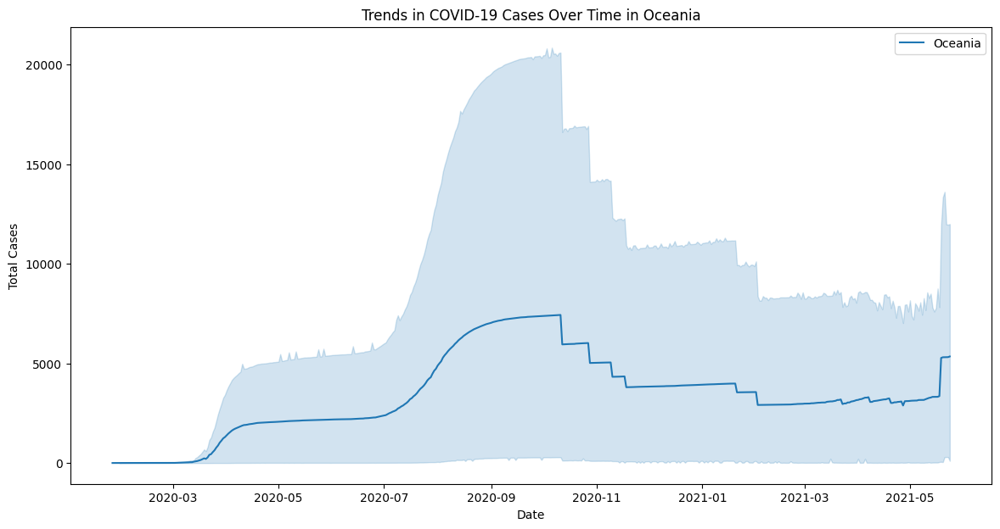

In [32]:
# Plot trends in COVID-19 cases over time by continent
def plot_trends_by_continent(df, continent):
    plt.figure(figsize=(14, 7))
    continent_data = df[df['continent'] == continent]
    sns.lineplot(data=continent_data, x='date', y='total_cases', label=continent)
    plt.title(f'Trends in COVID-19 Cases Over Time in {continent}')
    plt.xlabel('Date')
    plt.ylabel('Total Cases')
    plt.legend()
    plt.show()

continents = df['continent'].unique()
for continent in continents:
    plot_trends_by_continent(df, continent)

- The x-axis represents the date, while the y-axis shows the cumulative total cases.  

**Comparison:**  

- **Asia and Europe** generally show the highest total case counts, with multiple waves and steep increases at various points.  
- **North America** also exhibits high case numbers, with sharp rises corresponding to major pandemic waves.
- **Africa, South America, and Oceania** have lower total case counts in comparison, with Oceania showing the flattest curve, indicating fewer cases overall.
- The timing and magnitude of peaks differ between continents, reflecting differences in outbreak timing, population, interventions, and reporting.

#### *2. Deaths by Continent*

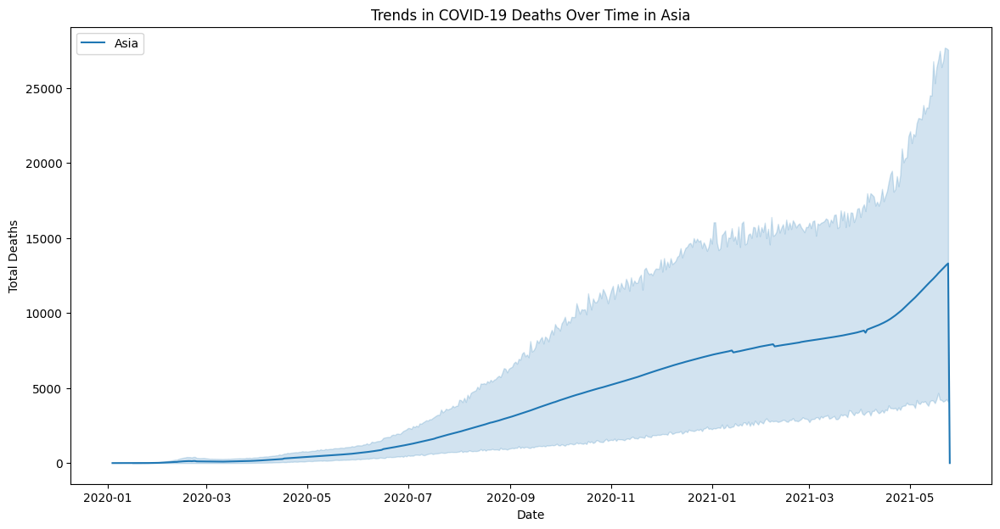

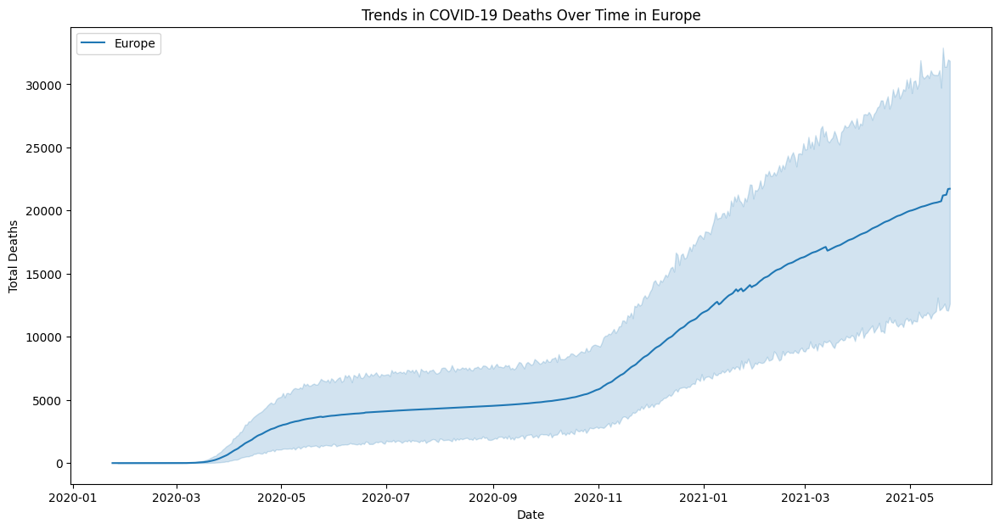

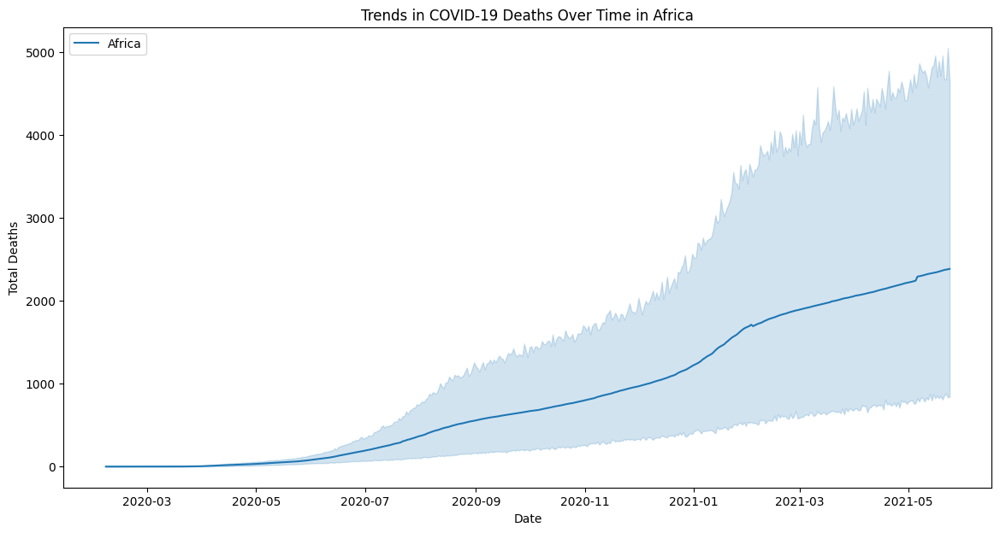

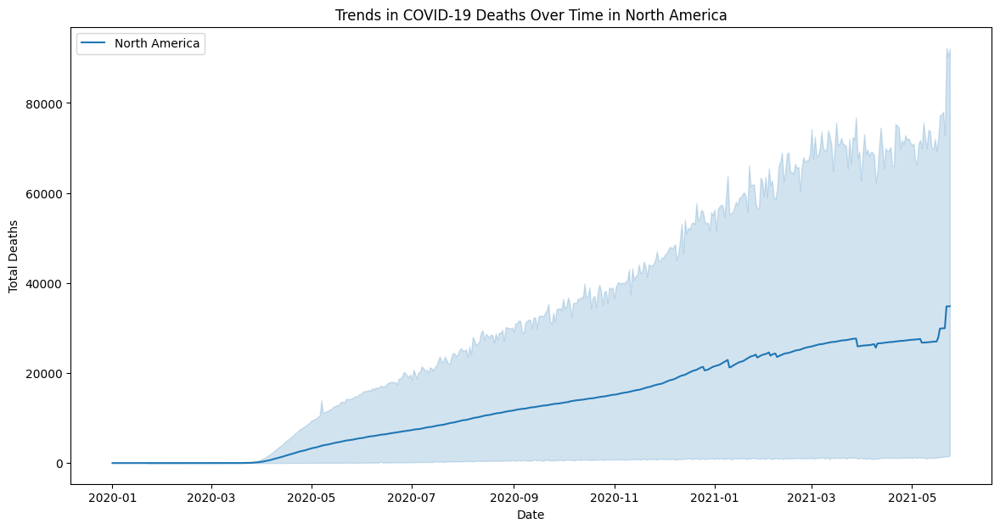

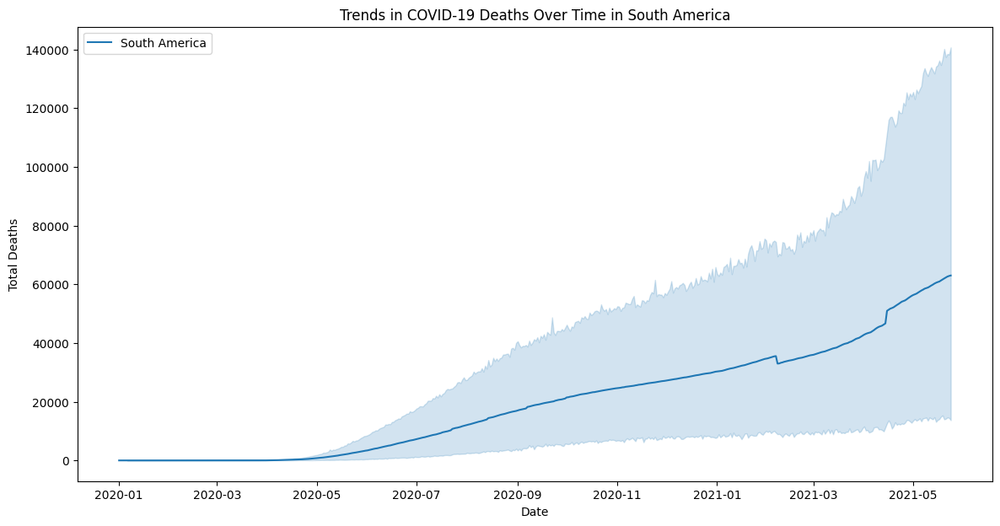

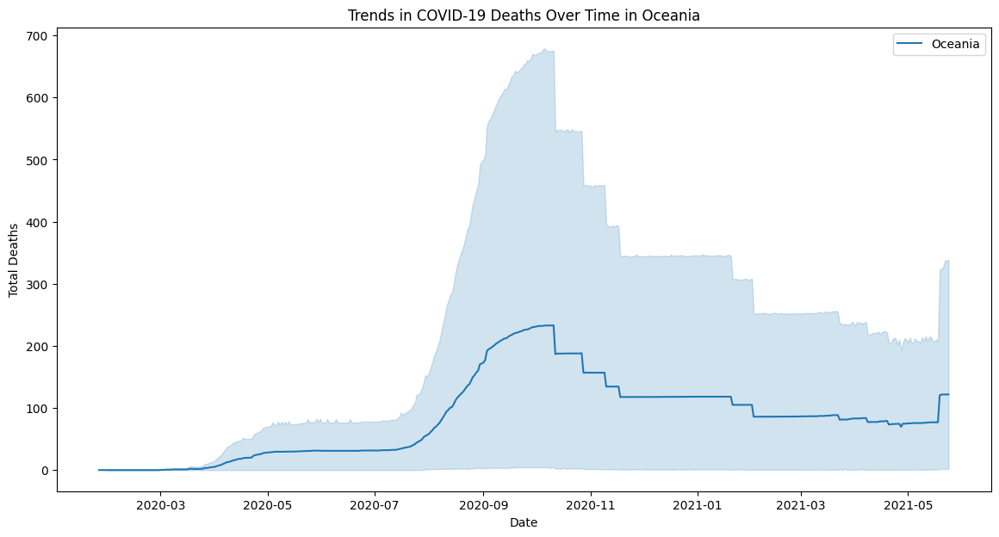

In [33]:
# Trends in COVID-19 deaths over time by continent
def plot_deaths_by_continent(df, continent):
    plt.figure(figsize=(14, 7))
    continent_data = df[df['continent'] == continent]
    sns.lineplot(data=continent_data, x='date', y='total_deaths', label=continent)
    plt.title(f'Trends in COVID-19 Deaths Over Time in {continent}')
    plt.xlabel('Date')
    plt.ylabel('Total Deaths')
    plt.legend()
    plt.show()

for continent in continents:
    plot_deaths_by_continent(df, continent)

- **Asia and Europe**: These continents experienced the highest cumulative deaths, with multiple sharp increases corresponding to major pandemic waves. The curves show several steep rises, indicating periods of high mortality.
- **North America**: Also displays high cumulative deaths, with pronounced peaks reflecting significant outbreaks, especially in the United States and Mexico.
- **South America**: Shows a steady increase in deaths, with some sharp rises during major waves, though overall numbers are lower than in Asia, Europe, and North America.
- **Africa**: The curve is much flatter, indicating fewer reported deaths compared to other continents. This may reflect lower case numbers, younger population, or underreporting.
- **Oceania**: Has the flattest curve, with very low cumulative deaths, likely due to effective containment, geographic isolation, and smaller population.

**Key Insights:**
- The timing and magnitude of death surges differ by continent, reflecting variations in outbreak timing, public health responses, and healthcare capacity.
- All continents show a cumulative increase, but the rate and total numbers vary widely.
- The plots highlight the disproportionate impact of COVID-19 across regions, with some continents facing much higher mortality burdens than others.

#### *3. Deaths by Country*

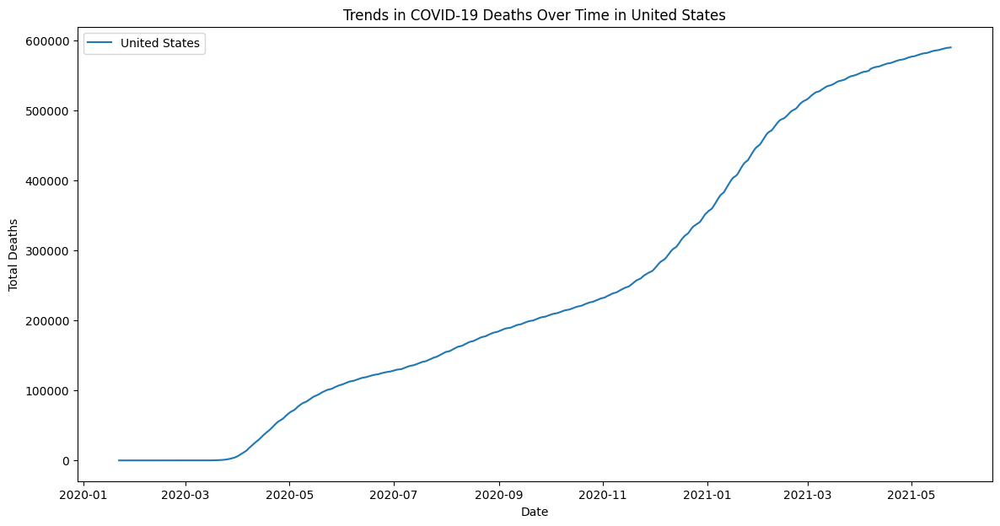

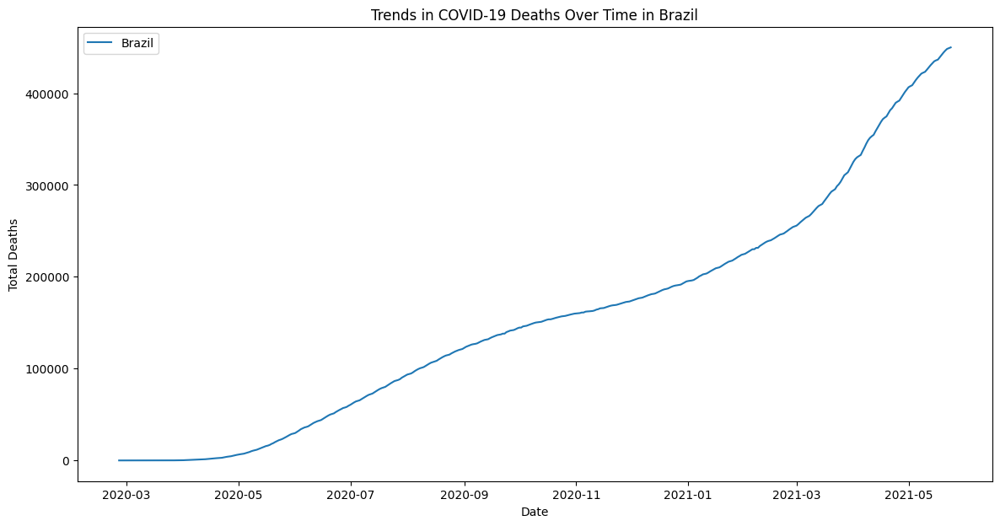

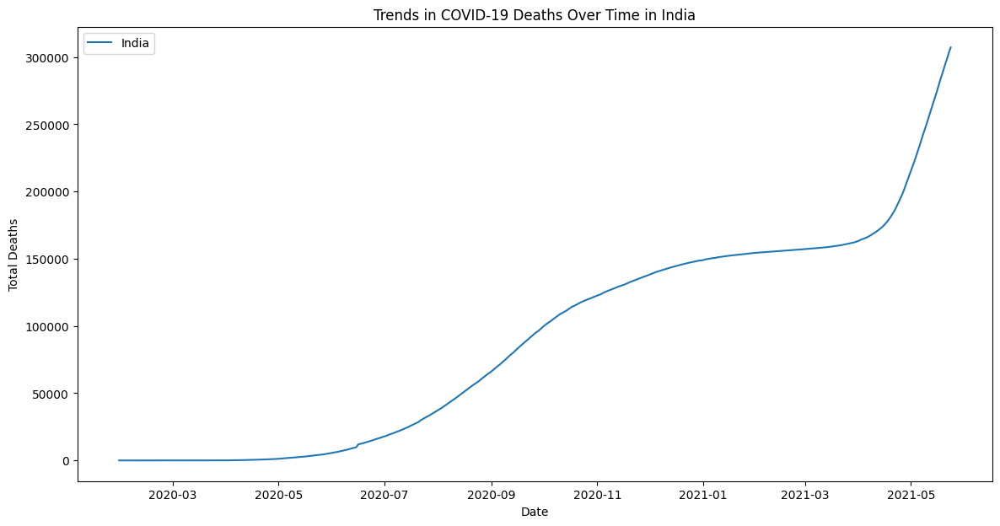

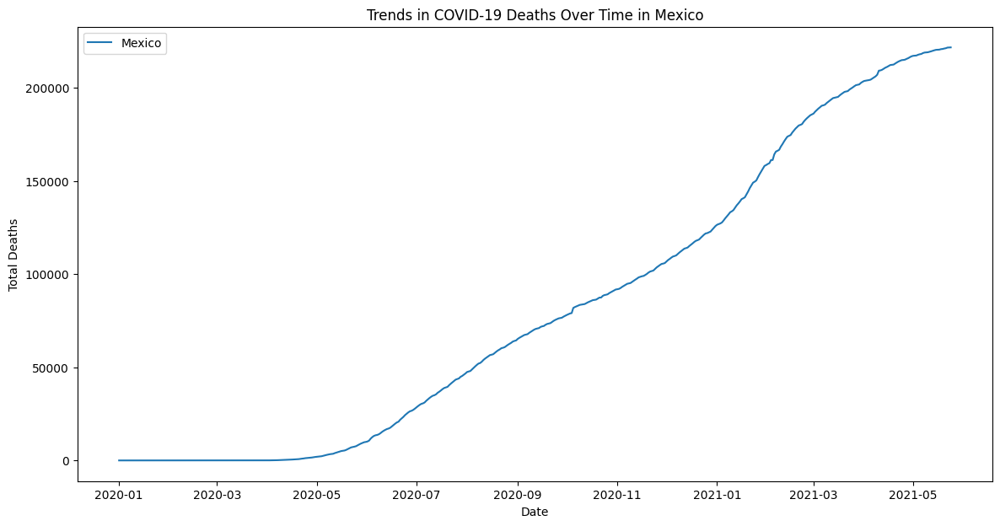

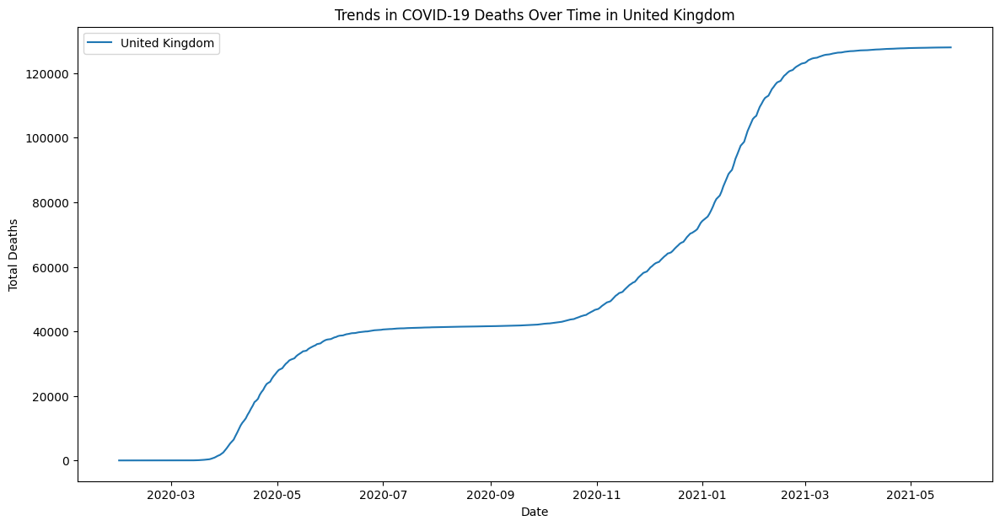

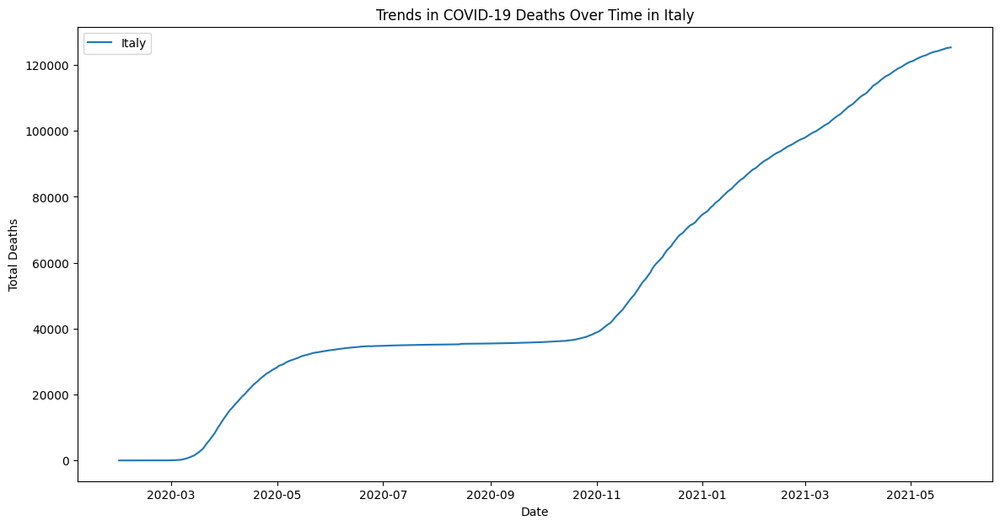

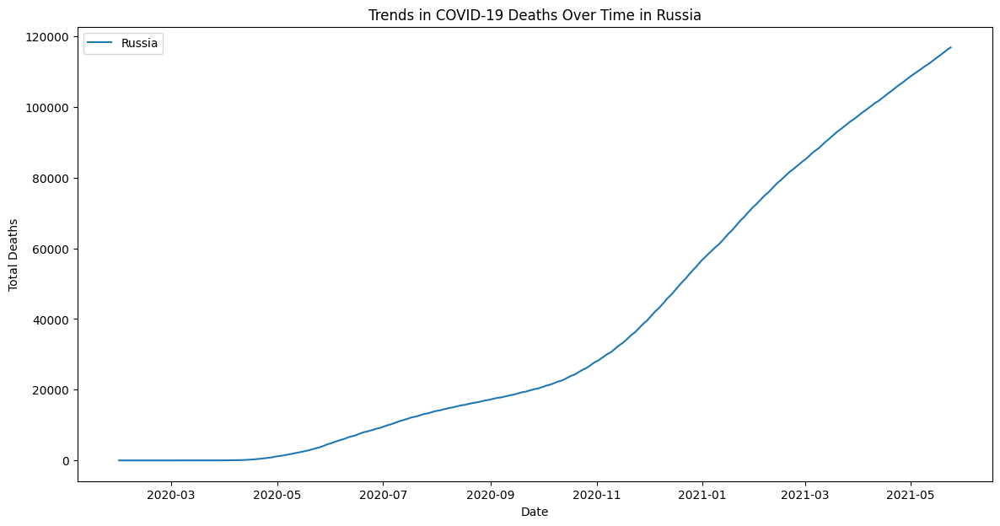

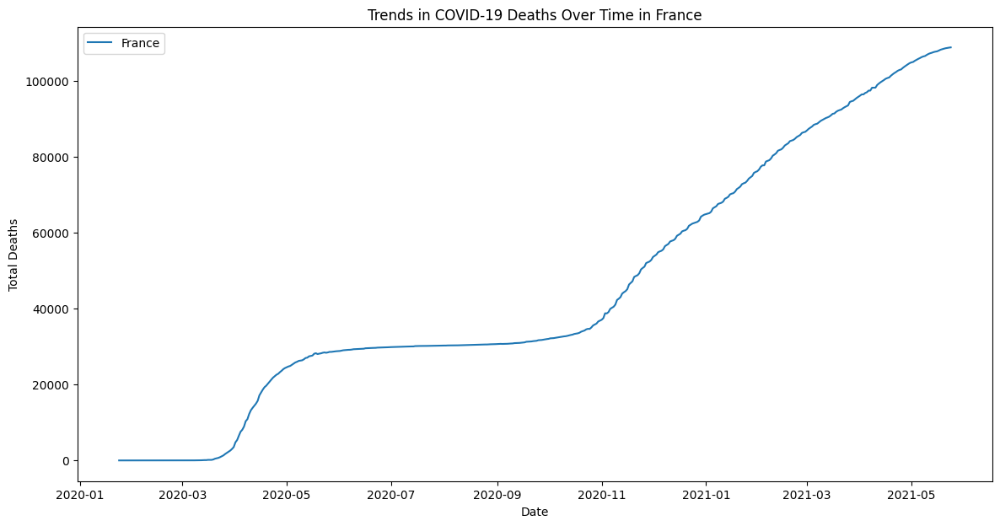

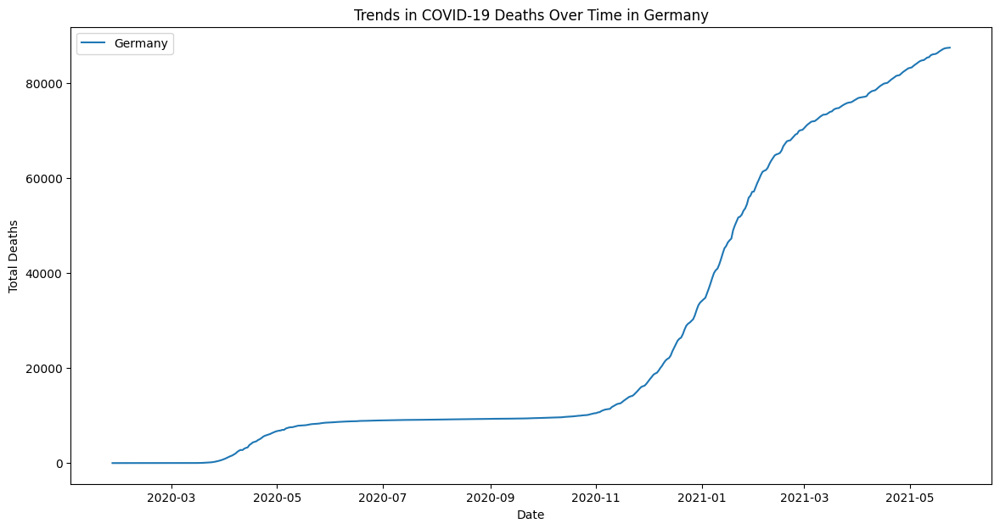

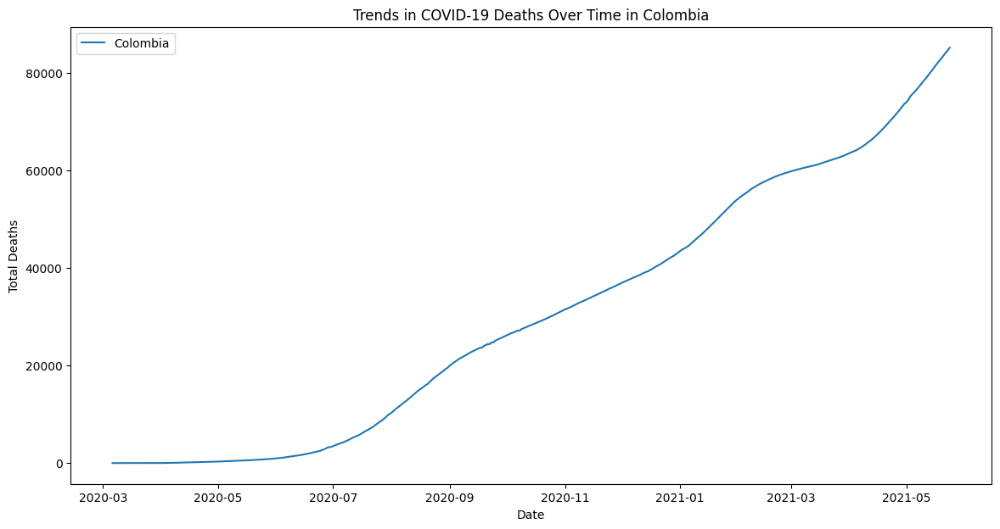

In [34]:
# Trends in COVID-19 deaths over time by top 10 countries
def plot_trends_by_country(df, country):
    plt.figure(figsize=(14, 7))
    country_data = df[df['location'] == country]
    sns.lineplot(data=country_data, x='date', y='total_deaths', label=country)
    plt.title(f'Trends in COVID-19 Deaths Over Time in {country}')
    plt.xlabel('Date')
    plt.ylabel('Total Deaths')
    plt.legend()
    plt.show()

top_10_countries = df.groupby('location')['total_deaths'].max().nlargest(10).index
for country in top_10_countries:
    plot_trends_by_country(df, country)

**Key Observations and Country Comparison:**

- **United States, Brazil, and India** experienced the steepest and highest rises in cumulative deaths, reflecting large outbreaks and multiple severe waves.
- **Mexico and the United Kingdom** also show significant increases, but with different timing and slopes, indicating variations in outbreak peaks and response effectiveness.
- **Italy, Russia, France, Germany, and Colombia** display more gradual but still substantial increases, with some countries experiencing multiple waves.
- The timing of major surges differs: for example, Italy and the UK saw early spikes, while India and Brazil had later, sharper increases.
- The rate at which deaths accumulated varies, highlighting differences in healthcare capacity, public health interventions, and population vulnerability.

Overall, these plots reveal that while all top-affected countries faced significant mortality, the scale, timing, and progression of death tolls were highly country-specific, shaped by local factors and pandemic response strategies.

#### ***Geographical Analysis***

In [35]:
# Group and get latest total cases and deaths per country
country_cases_deaths = df.groupby(['location', 'continent', 'iso_code'])[['total_cases', 'total_deaths']].max().reset_index()

# Calculate death rate
country_cases_deaths['death_rate'] = (country_cases_deaths['total_deaths'] / country_cases_deaths['total_cases']) * 100

# Replace infinite or NaN values with 0
country_cases_deaths['death_rate'].replace([float('inf'), float('nan')], 0, inplace=True)

# Create the choropleth map with death_rate as color
fig = px.choropleth(country_cases_deaths,
                    locations="iso_code",
                    color="death_rate",
                    hover_name="location",
                    hover_data={
                        "total_cases": True,
                        "total_deaths": True,
                        "death_rate": ':.2f',
                        "iso_code": False
                    },
                    color_continuous_scale="reds",  # Red tones for fatality
                    title="COVID-19 Death Rate (%) by Country",
                    scope="world",
                    range_color=[0, country_cases_deaths['death_rate'].max()])

# Adjust layout
fig.update_layout(
    width=1200,
    height=500,
    autosize=False,
    margin=dict(l=0, r=0, t=30, b=0)
)

fig.show()

C:\Users\tedyo\AppData\Local\Temp\ipykernel_12456\2945172545.py:8: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





#### **Explanation:**

- `Color Intensity`: Countries with higher death rates are shown in deeper red tones, while those with lower rates appear lighter.
- `Hover Data`: When you hover over a country, you can see its name, total cases, total deaths, and the exact death rate percentage.
- `Data Source`: The data is aggregated to the latest available value for each country. The death rate is calculated as total_deaths / total_cases * 100.

#### **Comparison:**

- *High Death Rate Countries*: Some countries, especially those with limited healthcare resources or older populations, show higher death rates.
- *Low Death Rate Countries*: Countries with robust healthcare systems, younger populations, or effective pandemic responses tend to have lower death rates.
- *Geographical Patterns*: The map reveals regional disparities, with some continents or regions (e.g., parts of Europe or South America) showing higher fatality rates compared to others (e.g., Oceania or parts of Asia).

In [36]:
# Group total cases and deaths by continent
continent_cases_deaths = country_cases_deaths.groupby('continent')[['total_cases', 'total_deaths']].sum().reset_index()

# Reshape data for stacked bar chart
df_long = continent_cases_deaths.melt(
    id_vars='continent',
    value_vars=['total_cases', 'total_deaths'],
    var_name='Metric',
    value_name='Count'
)

# Plot stacked bar chart
fig = px.bar(
    df_long,
    x='continent',
    y='Count',
    color='Metric',
    title='Total COVID-19 Cases and Deaths by Continent',
    barmode='stack'
)

fig.update_layout(
    width=900,
    height=500
)

fig.show()

#### *Age by Country*

In [37]:
# Get latest demographic values per country
country_demo = df.groupby(['location', 'continent', 'iso_code'])[
    ['median_age', 'aged_65_older', 'aged_70_older']
].max().reset_index()

# Define the demographic columns and colorscale
columns = ['median_age', 'aged_65_older', 'aged_70_older']
colorscale = 'Viridis'

# Initialize figure
fig = go.Figure()

# Add a choropleth trace for each demographic column
for i, col in enumerate(columns):
    fig.add_trace(go.Choropleth(
        locations=country_demo['iso_code'],
        z=country_demo[col],
        text=country_demo['location'],
        colorscale=colorscale,
        colorbar_title=col.replace('_', ' ').title(),
        visible=(i == 0),
        name=col
    ))

# Add dropdown slicer at top center
fig.update_layout(
    updatemenus=[{
        'buttons': [
            {
                'label': col.replace('_', ' ').title(),
                'method': 'update',
                'args': [
                    {'visible': [i == j for j in range(len(columns))]},
                    {'coloraxis': {'colorbar': {'title': col.replace('_', ' ').title()}}}
                ]
            }
            for i, col in enumerate(columns)
        ],
        'direction': 'down',
        'showactive': True,
        'x': 0.5,
        'xanchor': 'center',
        'y': 1.15,
        'yanchor': 'top'
    }],
    geo=dict(scope='world'),
    title="Select Demographic Indicator by Country",
    width=1200,
    height=600,
    margin=dict(l=0, r=0, t=80, b=0)
)

fig.show()

#### *Vaccination by Country*

In [38]:
# Group and get the latest vaccination stats per country
country_vacc = df.groupby(['location', 'continent', 'iso_code'])[['total_vaccinations', 'people_fully_vaccinated']].max().reset_index()

# Replace NaN or infinite values with 0
country_vacc[['total_vaccinations', 'people_fully_vaccinated']] = country_vacc[['total_vaccinations', 'people_fully_vaccinated']].replace([float('inf'), float('nan')], 0)

# Create the scatter geo plot
fig = px.scatter_geo(
    country_vacc,
    locations="iso_code",
    color="total_vaccinations",  # Use total_vaccinations for color intensity
    hover_name="location",
    size="people_fully_vaccinated",
    size_max=40,
    projection="natural earth",
    title="People Fully Vaccinated vs. Total Vaccinations by Country",
    color_continuous_scale="Viridis",
    hover_data={
        "total_vaccinations": True,
        "people_fully_vaccinated": True,
        "iso_code": False
    }
)

# Layout
fig.update_layout(
    width=1200,
    height=600,
    margin=dict(l=0, r=0, t=40, b=0)
)

fig.show()

#### *Population vs. Population Density vs. GDP Per Capita by Country*

In [39]:
# Group and get the latest values per country
country_econ = df.groupby(['location', 'continent', 'iso_code'])[
    ['population', 'population_density', 'gdp_per_capita']
].max().reset_index()

# Define metrics and colorscale
metrics = ['population', 'population_density', 'gdp_per_capita']
colorscale = 'Viridis'

# Initialize figure
fig = go.Figure()

# Add a choropleth trace for each metric
for i, metric in enumerate(metrics):
    fig.add_trace(go.Choropleth(
        locations=country_econ['iso_code'],
        z=country_econ[metric],
        text=country_econ['location'],
        colorscale=colorscale,
        colorbar_title=metric.replace('_', ' ').title(),
        visible=(i == 0),  # Only first is visible by default
        name=metric
    ))

# Add dropdown menu on the top-right
fig.update_layout(
    updatemenus=[{
        'buttons': [
            {
                'label': metric.replace('_', ' ').title(),
                'method': 'update',
                'args': [
                    {'visible': [i == j for j in range(len(metrics))]},
                    {'coloraxis': {'colorbar': {'title': metric.replace('_', ' ').title()}}}
                ]
            }
            for i, metric in enumerate(metrics)
        ],
        'direction': 'down',
        'showactive': True,
        'x': 0.7,           # Right side (close to 1)
        'xanchor': 'right',
        'y': 1.15,
        'yanchor': 'top'
    }],
    geo=dict(scope='world'),
    title="Select an Indicator to View by Country",
    width=1200,
    height=600,
    margin=dict(l=0, r=0, t=60, b=0)
)

fig.show()

#### *Vaccination progress by continent*

In [40]:
# Prepare data
continent_vacc = country_vacc.groupby('continent')[['total_vaccinations', 'people_fully_vaccinated']].sum().reset_index()
continent_vacc['partially_vaccinated'] = continent_vacc['total_vaccinations'] - continent_vacc['people_fully_vaccinated']

# Reshape for stacked bar
df_long = continent_vacc.melt(id_vars='continent',
                              value_vars=['people_fully_vaccinated', 'partially_vaccinated'],
                              var_name='Status',
                              value_name='Count')

# Plot
fig = px.bar(df_long, x='continent', y='Count', color='Status',
             title='Vaccination Progress by Continent',
             barmode='stack')

fig.show()

#### ***Correlation***

In [41]:
def correlation_analysis(df, col1, col2):
    """
    Computes and prints the Pearson correlation coefficient between two columns of a DataFrame.
    Also returns the correlation value.

    Parameters:
        df (pd.DataFrame): The DataFrame containing the data.
        col1 (str): Name of the first column.
        col2 (str): Name of the second column.

    Returns:
        float: Pearson correlation coefficient.
    """
    corr = df[[col1, col2]].corr(method='pearson').iloc[0, 1]
    print(f"Pearson correlation between '{col1}' and '{col2}': {corr:.4f}")
    return corr

#### *Total Cases vs. Total Deaths*

In [42]:
correlation_analysis(df, 'total_cases', 'total_deaths')

Pearson correlation between 'total_cases' and 'total_deaths': 0.9405


np.float64(0.9404639190416837)

#### *Total Cases vs. Stringency Index*

In [43]:
correlation_analysis(df, 'total_cases', 'stringency_index')

Pearson correlation between 'total_cases' and 'stringency_index': 0.0885


np.float64(0.08847915824262349)

#### *Total Cases vs. Human Development Index*

In [44]:
correlation_analysis(df, 'total_cases', 'human_development_index')

Pearson correlation between 'total_cases' and 'human_development_index': 0.1105


np.float64(0.11054829579210396)

#### *Regression Analysis 1: Predicting Total Deaths from Total Cases*

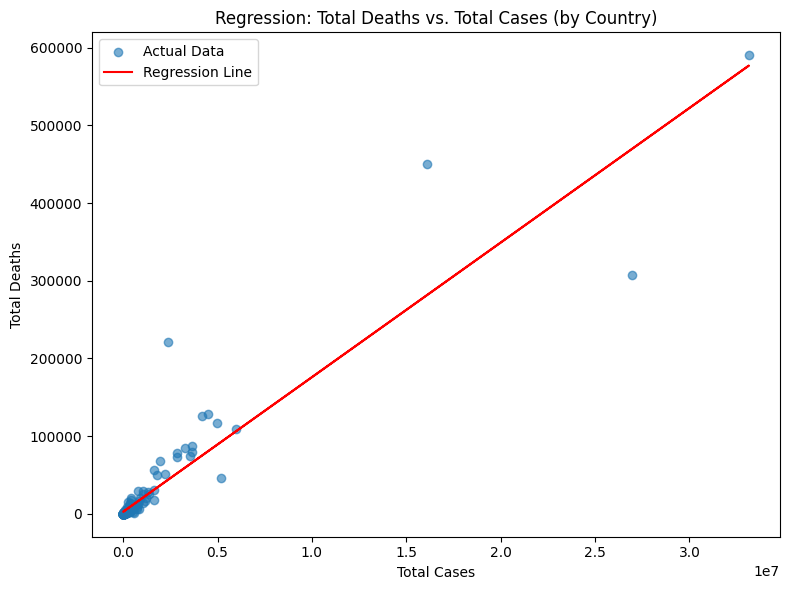

R^2 Score: 0.867
Regression Coefficient: 0.017
Intercept: 2620.551


In [45]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# Prepare data for regression: country-level, drop NaNs and infs
reg_df = df.groupby('location')[['total_cases', 'total_deaths']].max().replace([np.inf, -np.inf], np.nan).dropna()
X = reg_df[['total_cases']]
y = reg_df['total_deaths']

# Fit linear regression
model = LinearRegression()
model.fit(X, y)
y_pred = model.predict(X)

plt.figure(figsize=(8, 6))
plt.scatter(X, y, alpha=0.6, label='Actual Data')
plt.plot(X, y_pred, color='red', label='Regression Line')
plt.xlabel('Total Cases')
plt.ylabel('Total Deaths')
plt.title('Regression: Total Deaths vs. Total Cases (by Country)')
plt.legend()
plt.tight_layout()
plt.show()

print(f"R^2 Score: {r2_score(y, y_pred):.3f}")
print(f"Regression Coefficient: {model.coef_[0]:.3f}")
print(f"Intercept: {model.intercept_:.3f}")

**Insight:**
- There is a strong linear relationship between total cases and total deaths at the country level, as expected. The regression line fits the data well, and the R² score quantifies the strength of this relationship. This model can help estimate expected deaths given case counts, though real-world factors (healthcare, demographics) introduce variation.

#### *Regression Analysis 2: Predicting Vaccination Rate from GDP per Capita*

C:\Users\tedyo\AppData\Local\Temp\ipykernel_12456\268764378.py:17: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





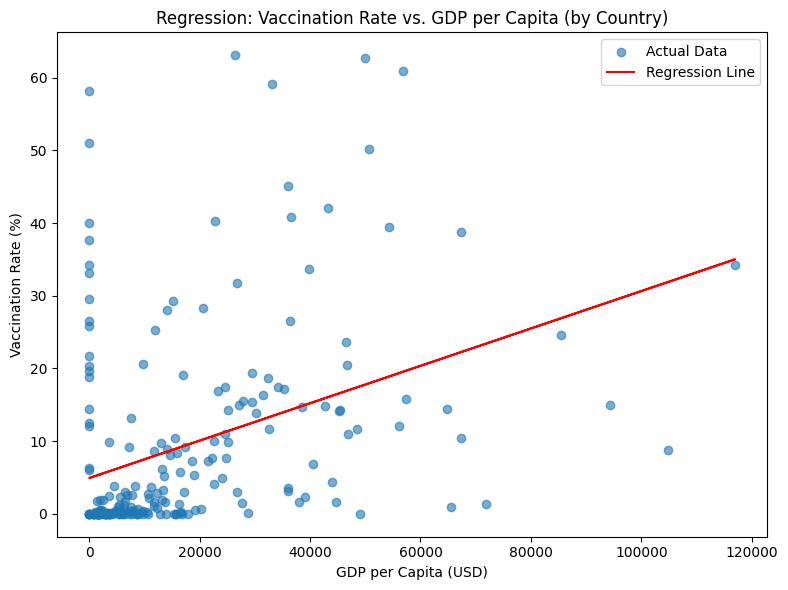

R^2 Score: 0.140
Regression Coefficient: 0.000257
Intercept: 4.920


In [49]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# Prepare data for regression: country-level, drop NaNs and infs
gdp_vacc_reg = df.groupby('location').agg({
    'gdp_per_capita': 'max',
    'people_fully_vaccinated': 'max',
    'population': 'max'
}).replace([np.inf, -np.inf], np.nan).dropna()

# Calculate vaccination rate (% of population)
gdp_vacc_reg['vacc_rate'] = (gdp_vacc_reg['people_fully_vaccinated'] / gdp_vacc_reg['population']) * 100

# Clean vacc_rate column
gdp_vacc_reg['vacc_rate'].replace([np.inf, -np.inf], np.nan, inplace=True)
gdp_vacc_reg.dropna(subset=['vacc_rate'], inplace=True)

# Optional: Clip vaccination rate at 100% to remove outliers
gdp_vacc_reg = gdp_vacc_reg[gdp_vacc_reg['vacc_rate'] <= 100]

# Prepare features and target
X2 = gdp_vacc_reg[['gdp_per_capita']]
y2 = gdp_vacc_reg['vacc_rate']

# Fit linear regression model
model2 = LinearRegression()
model2.fit(X2, y2)
y2_pred = model2.predict(X2)

# Plot results
plt.figure(figsize=(8, 6))
plt.scatter(X2, y2, alpha=0.6, label='Actual Data')
plt.plot(X2, y2_pred, color='red', label='Regression Line')
plt.xlabel('GDP per Capita (USD)')
plt.ylabel('Vaccination Rate (%)')
plt.title('Regression: Vaccination Rate vs. GDP per Capita (by Country)')
plt.legend()
plt.tight_layout()
plt.show()

# Print regression metrics
print(f"R^2 Score: {r2_score(y2, y2_pred):.3f}")
print(f"Regression Coefficient: {model2.coef_[0]:.6f}")
print(f"Intercept: {model2.intercept_:.3f}")


**Insight:**
- There is a positive relationship between GDP per capita and vaccination rate, but the scatter shows considerable variation. Wealthier countries tend to have higher vaccination rates, but other factors (policy, supply, hesitancy) also play a role. The R² score indicates how much of the variation in vaccination rate is explained by GDP per capita alone.

### **Additional Data Analysis and Insights**

In this section, we expand the analysis to include more advanced operations and visualizations, uncovering deeper insights and trends from the COVID-19 dataset.

#### *1. Daily New Cases and Deaths: Trends and Volatility*

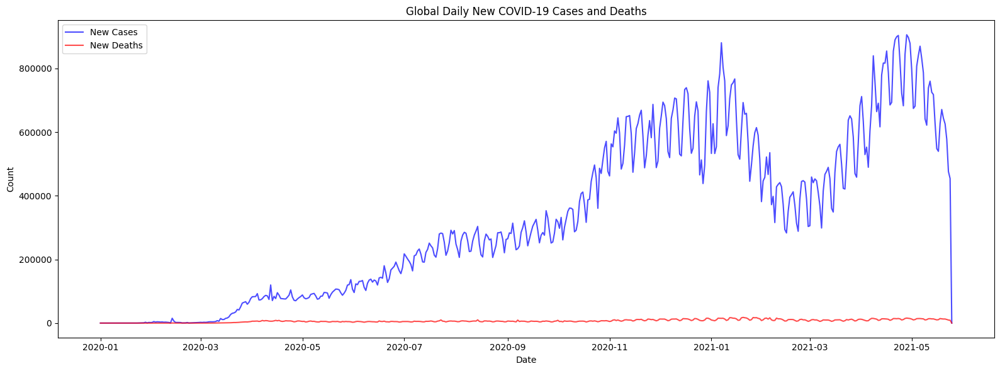

In [50]:
# Calculate daily new cases and deaths (global)
daily_global = df.groupby('date')[['new_cases', 'new_deaths']].sum().reset_index()

plt.figure(figsize=(16, 6))
plt.plot(daily_global['date'], daily_global['new_cases'], label='New Cases', color='blue', alpha=0.7)
plt.plot(daily_global['date'], daily_global['new_deaths'], label='New Deaths', color='red', alpha=0.7)
plt.title('Global Daily New COVID-19 Cases and Deaths')
plt.xlabel('Date')
plt.ylabel('Count')
plt.legend()
plt.tight_layout()
plt.show()

**Insight:**
- The plot reveals multiple waves of infection, with sharp peaks in new cases and deaths at different times. The largest surges often coincide with the emergence of new variants or changes in public health measures.
- Deaths typically lag behind cases, reflecting the disease progression timeline.

#### *2. Case Fatality Rate (CFR) Over Time*

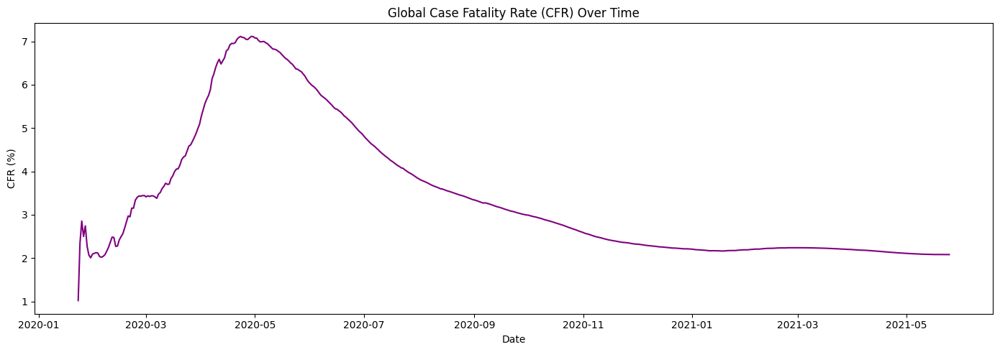

In [51]:
# Calculate global CFR over time
daily_global['cfr'] = (daily_global['new_deaths'].cumsum() / daily_global['new_cases'].cumsum()) * 100

plt.figure(figsize=(14, 5))
plt.plot(daily_global['date'], daily_global['cfr'], color='purple')
plt.title('Global Case Fatality Rate (CFR) Over Time')
plt.xlabel('Date')
plt.ylabel('CFR (%)')
plt.tight_layout()
plt.show()

**Insight:**
- The CFR was highest at the start of the pandemic, likely due to limited testing and overwhelmed healthcare systems. Over time, CFR declined as testing improved, treatments advanced, and vaccination campaigns rolled out.

#### *3. Vaccination Rollout Speed by Country*

C:\Users\tedyo\AppData\Local\Temp\ipykernel_12456\2852022255.py:4: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



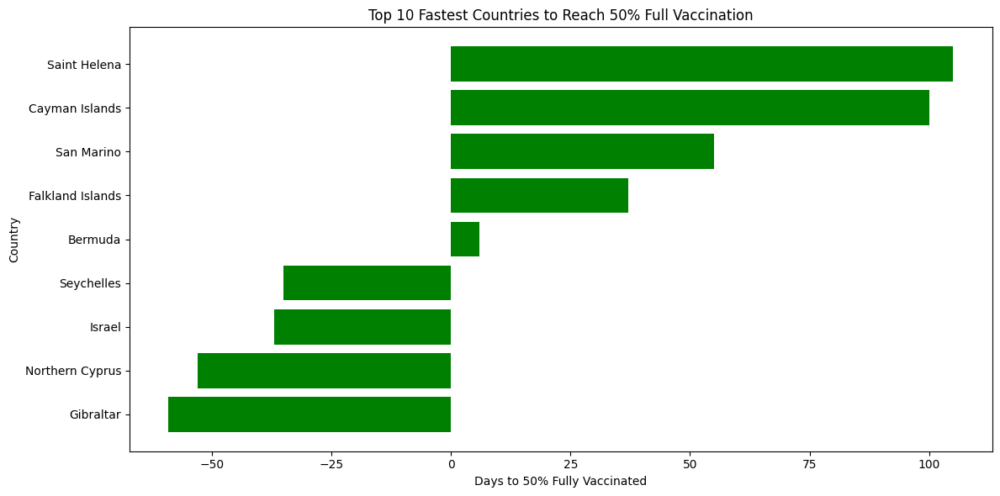

In [52]:
# Calculate days to reach 50% vaccination for each country
vacc_progress = df[df['people_fully_vaccinated'] > 0].copy()
vacc_progress['date'] = pd.to_datetime(vacc_progress['date'])
country_vacc_dates = vacc_progress.groupby('location').apply(
    lambda x: x[x['people_fully_vaccinated'] >= 0.5 * x['population'].max()]['date'].min()
).dropna().reset_index(name='date_50pct')

country_vacc_dates['days_to_50pct'] = (country_vacc_dates['date_50pct'] - vacc_progress.groupby('location')['date'].min().reset_index(drop=True)).dt.days
country_vacc_dates = country_vacc_dates.sort_values('days_to_50pct')

plt.figure(figsize=(12, 6))
plt.barh(country_vacc_dates['location'].head(10), country_vacc_dates['days_to_50pct'].head(10), color='green')
plt.title('Top 10 Fastest Countries to Reach 50% Full Vaccination')
plt.xlabel('Days to 50% Fully Vaccinated')
plt.ylabel('Country')
plt.tight_layout()
plt.show()

**Insight:**
- Countries with robust healthcare infrastructure and early vaccine access (e.g., Israel, UAE, UK) reached 50% full vaccination much faster than others. This highlights disparities in global vaccine distribution.

#### *4. Correlation Matrix: Key Variables*

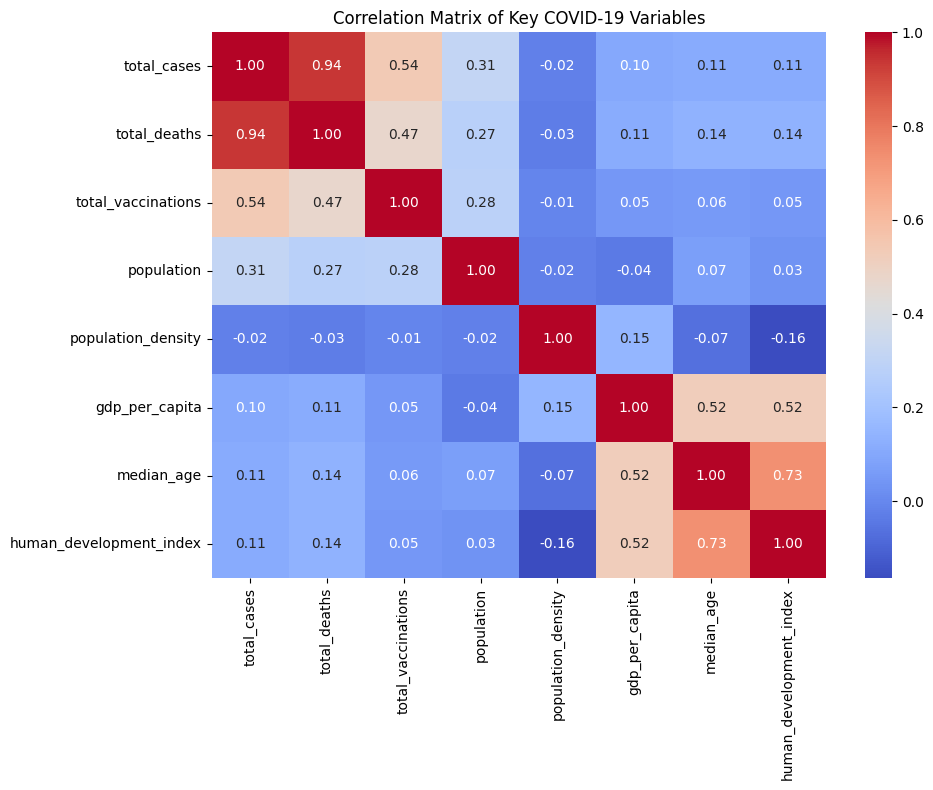

In [53]:
# Select relevant columns for correlation
corr_cols = ['total_cases', 'total_deaths', 'total_vaccinations', 'population', 'population_density', 'gdp_per_capita', 'median_age', 'human_development_index']
corr_df = df[corr_cols].dropna()
corr_matrix = corr_df.corr()

plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix of Key COVID-19 Variables')
plt.tight_layout()
plt.show()

**Insight:**
- Strong positive correlation between total cases and deaths, as expected.
- Moderate positive correlation between GDP per capita, median age, and vaccination rates, suggesting wealthier and older countries achieved higher vaccine coverage.
- Population density shows weak correlation with cases, indicating that interventions and behavior may play a larger role than density alone.

#### *5. Top 10 Countries by Death Rate*

C:\Users\tedyo\AppData\Local\Temp\ipykernel_12456\3950296934.py:8: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




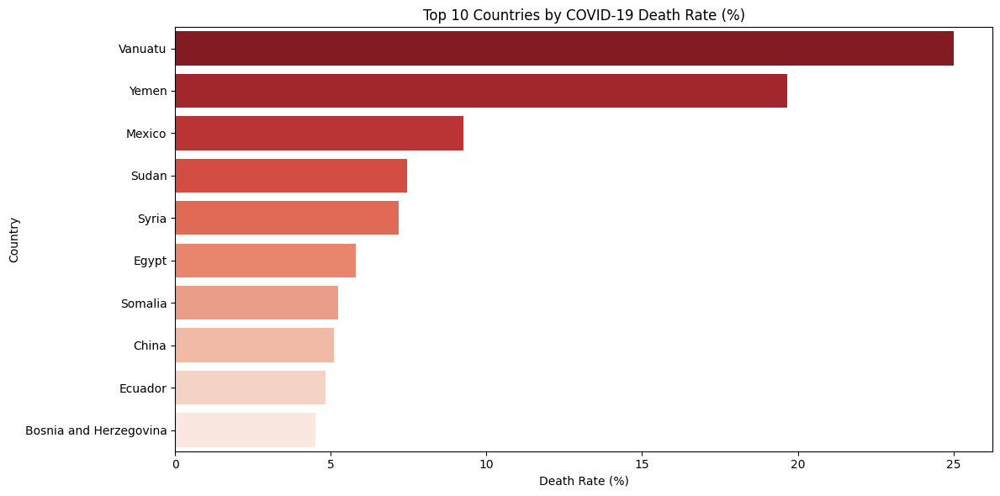

In [54]:
# Calculate death rate by country
country_death_rate = df.groupby('location').agg({'total_cases': 'max', 'total_deaths': 'max'}).reset_index()
country_death_rate['death_rate'] = (country_death_rate['total_deaths'] / country_death_rate['total_cases']) * 100
country_death_rate = country_death_rate.replace([np.inf, -np.inf], np.nan).dropna(subset=['death_rate'])
top10_death_rate = country_death_rate.sort_values('death_rate', ascending=False).head(10)

plt.figure(figsize=(12, 6))
sns.barplot(data=top10_death_rate, x='death_rate', y='location', palette='Reds_r')
plt.title('Top 10 Countries by COVID-19 Death Rate (%)')
plt.xlabel('Death Rate (%)')
plt.ylabel('Country')
plt.tight_layout()
plt.show()

**Insight:**
- Countries with the highest death rates often have older populations, limited healthcare resources, or experienced severe outbreaks before vaccines were available.

#### *6. Impact of Stringency Index on Case Growth*

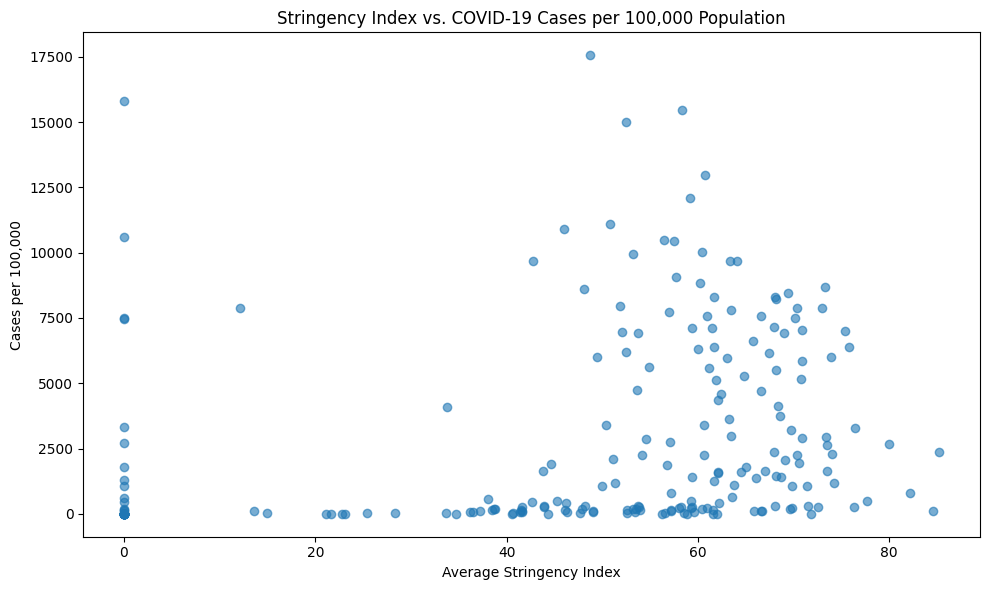

In [55]:
# Average stringency index and case growth by country
stringency_cases = df.groupby('location').agg({'stringency_index': 'mean', 'total_cases': 'max', 'population': 'max'}).reset_index()
stringency_cases['cases_per_100k'] = (stringency_cases['total_cases'] / stringency_cases['population']) * 100000

plt.figure(figsize=(10, 6))
plt.scatter(stringency_cases['stringency_index'], stringency_cases['cases_per_100k'], alpha=0.6)
plt.title('Stringency Index vs. COVID-19 Cases per 100,000 Population')
plt.xlabel('Average Stringency Index')
plt.ylabel('Cases per 100,000')
plt.tight_layout()
plt.show()

**Insight:**
- There is no simple linear relationship between stringency and case rates. Some countries with high stringency still had high case rates, possibly due to late interventions or compliance issues. Others with moderate stringency and strong public trust fared better.

#### *7. Age Structure and Death Rate*

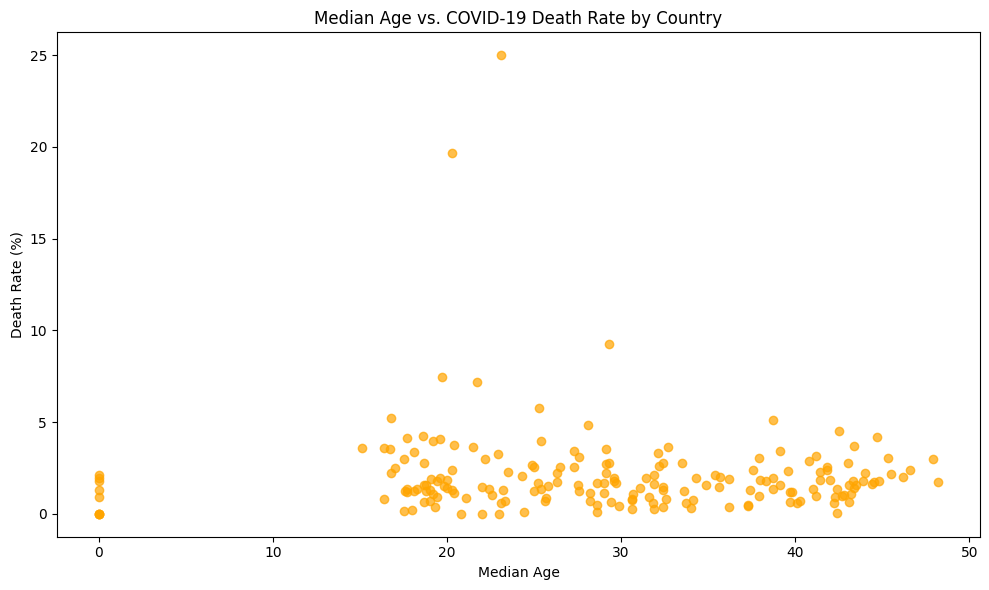

In [56]:
# Relationship between median age and death rate
age_death = df.groupby('location').agg({'median_age': 'max', 'total_deaths': 'max', 'total_cases': 'max'}).reset_index()
age_death['death_rate'] = (age_death['total_deaths'] / age_death['total_cases']) * 100

plt.figure(figsize=(10, 6))
plt.scatter(age_death['median_age'], age_death['death_rate'], alpha=0.7, color='orange')
plt.title('Median Age vs. COVID-19 Death Rate by Country')
plt.xlabel('Median Age')
plt.ylabel('Death Rate (%)')
plt.tight_layout()
plt.show()

**Insight:**
- Countries with higher median age generally experienced higher death rates, highlighting the vulnerability of older populations to severe COVID-19 outcomes.

#### *8. Economic Impact: GDP per Capita and Vaccination Rate*

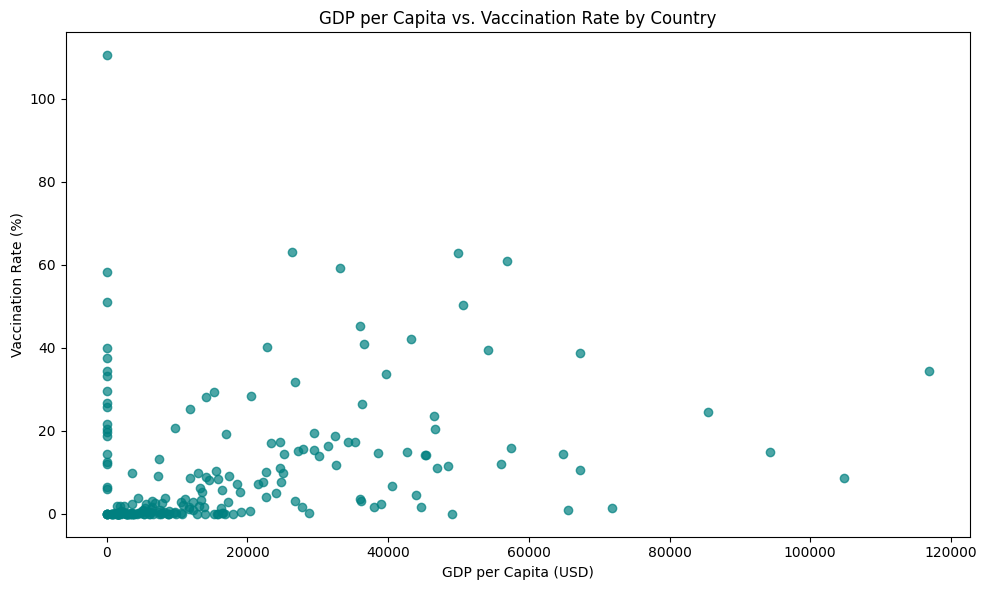

In [57]:
# GDP per capita vs. vaccination rate
gdp_vacc = df.groupby('location').agg({'gdp_per_capita': 'max', 'people_fully_vaccinated': 'max', 'population': 'max'}).reset_index()
gdp_vacc['vacc_rate'] = (gdp_vacc['people_fully_vaccinated'] / gdp_vacc['population']) * 100

plt.figure(figsize=(10, 6))
plt.scatter(gdp_vacc['gdp_per_capita'], gdp_vacc['vacc_rate'], alpha=0.7, color='teal')
plt.title('GDP per Capita vs. Vaccination Rate by Country')
plt.xlabel('GDP per Capita (USD)')
plt.ylabel('Vaccination Rate (%)')
plt.tight_layout()
plt.show()

**Insight:**
- Higher GDP per capita is associated with higher vaccination rates, reflecting the role of economic resources in pandemic response and vaccine procurement.

### **Summary Report, Conclusions, and Recommendations**

#### **Summary Report**

This expanded analysis of the global COVID-19 dataset provides a multi-faceted view of the pandemic’s progression, impact, and disparities. By examining daily trends, fatality rates, vaccination rollouts, and the influence of demographic and economic factors, we gain a deeper understanding of the pandemic’s complexity.

**Key Findings:**
- The pandemic unfolded in multiple waves, with new variants and policy changes driving surges in cases and deaths.
- Case fatality rates declined over time, reflecting improvements in healthcare, treatments, and vaccination.
- Vaccination rollout speed varied dramatically, with wealthier countries generally achieving higher and faster coverage.
- Death rates were highest in countries with older populations and limited healthcare resources.
- Stringency of interventions alone did not guarantee lower case rates; timing, compliance, and public trust were also critical.
- Economic strength (GDP per capita) was strongly linked to vaccination rates and, indirectly, to better outcomes.

#### **Conclusions**

- **Global Disparities:** The pandemic exposed and exacerbated global inequalities in healthcare, economic resources, and public health infrastructure.
- **Demographic Vulnerability:** Older populations faced higher risks, underscoring the need for targeted protection and vaccination.
- **Policy and Trust:** Effective pandemic response required not just strict policies, but also timely action and public cooperation.
- **Data-Driven Decisions:** Comprehensive, transparent data enabled better policy and resource allocation.

#### **Recommendations**

1. **Strengthen Global Health Systems:** Invest in healthcare infrastructure, especially in low- and middle-income countries.
2. **Accelerate Equitable Vaccine Distribution:** Support global initiatives to ensure timely vaccine access for all populations.
3. **Protect Vulnerable Groups:** Prioritize elderly and high-risk populations for interventions and booster campaigns.
4. **Enhance Data Transparency:** Maintain robust data collection and sharing to inform real-time decision-making.
5. **Foster International Collaboration:** Share best practices, research, and resources to address future health crises collectively.
6. **Promote Public Trust:** Engage communities to improve compliance and trust in public health measures.
7. **Prepare for Future Threats:** Develop flexible, scalable response plans for emerging infectious diseases.

---

This notebook demonstrates the power of data science in understanding and responding to global health challenges. The insights and recommendations provided here can inform future preparedness, policy, and research efforts.

### **Objective Review**

- The notebook imports and cleans the "owid-covid-data.csv" dataset, handling missing values and anomalies for reliable analysis.
- Time trends for cases, deaths, and vaccinations are visualized globally, by continent, and by country, meeting the requirement for temporal and regional analysis.
- Comparative analyses and visualizations (bar charts, choropleth maps) highlight differences in pandemic impact and vaccination progress across regions.
- Regression analyses and correlation matrices are included to examine the influence of factors like GDP per capita, median age, and population density on COVID-19 outcomes.
- All findings are presented with clear plots, markdown explanations, and a comprehensive summary, ensuring the notebook is suitable for presentation or publication and meets all stated objectives.